# Introducción a los Mínimos Cuadrados Recursivos.


## Objetivo

Analizar el funcionamiento de los mínimos cuadrados recursivos con el propósito de desarrollar modelos matemáticos robustos que permitan minimizar las perturbaciones inducidas por el ruido $e(k)$.

## Mínimos Cuadrados Ordinarios (OLS)

Un modelo en tiempo discreto que puede expresarse en forma matricial de la siguiente manera:

$$y(k)=\phi^T(k)\theta_k + e(k),$$

donde $\phi(k)$  es conocido como *vector de regresión* o simplemente *regresor* y contiene la información de las mediciones pasadas de las señales de entrada y salida, mientras que $\theta_k$ es el vector de parámetros desconocidos, el cual es el objetivo de la estimación.

Recordemos que el **objetivo de este técnica**, es *minimizar el error entre la medición y la predicción proporcionada por el modelo.*. Para ello, es necesario definir una función de costo que se debe minimizar. Con este fin, resulta conveniente introducir un vector denominado *error de predicción* $\epsilon(k)$:

$$\epsilon(k) = y(k)- \hat{y}(k),$$
$$\epsilon(k) = y(k) - \phi^T(k)\hat{\theta}_k, \quad (1)$$

El vector de parámetros $\theta_k$ se define como la estimación que minimiza la función de costo, la cual está dada por la ecuación ($2$):

$$V = \frac{1}{2}\epsilon^T(k)\epsilon(k), \quad (2)$$

A partir de la ecuación (2), se minimiza el cuadrado del error, para lo cual se iguala a cero la derivada parcial de $V$ respecto de $\theta_k$:

$$\frac{\partial V}{\partial \theta_k} = 0,$$

Al resolver esta ecuación, obtenemos que el vector de parámetros estimados es igual a:

$$\hat{\theta}_k = \left[\phi(k)\phi^T(k) \right]^{-1}[\phi(k)y(k)], \quad (3)$$

Esta última ecuación ($3$) nos permite estimar los parámetros del sistema y, por lo tanto, predecir el valor de la salida:

$$\hat{y}(k) = \phi^T \hat{\theta}_k,$$

Es importante notar que esta estimación conlleva un *alto costo computacional*, debido a que calcular la inversa de la matriz es costoso. Además, el vector de parámetros se calcula a partir de un conjunto de datos (es decir, es un **algoritmo por lotes**). Esto implica que la cantidad de memoria depende de número de datos (mediciones realizadas) y no se pueden agregar en ejecución, es decir, este algoritmo **no puede emplearse para la estimación en tiempo real**. Esto representa una limitación, ya que las tendencias actuales en el ámbito de control e instrumentación requieren técnicas de identificación en línea.

Este problema se ilustrará con un ejemplo, pero como primer paso, es necesario generar un conjunto de datos. Para ello, se utilizará una señal de entrada que consiste en una ventana cuadrada o un pulso.

```{note}
Si se desean realizar modificaciones en el código, favor de ejecutar la siguiente celda para la generación de datos y la importación de las bibliotecas necesarias. Una vez ejecutada, será posible ejecutar las celdas siguientes con las modificaciones requeridas.
```

In [12]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Señal de entrada
input_signal = np.concatenate((np.zeros(50), np.ones(50), np.zeros(50)))

# Ruido
e = 0.008 * np.random.randn(150)

# Señal de salida
output_signal = input_signal + e


Pasemos a la aplicación de los mínimos cuadrados ordinarios. En este ejemplo, se presenta el siguiente diagrama de bloques:

![Sistema del ejemplo](images/chapter1_figure1.png)


El análisis del código muestra que la señal de entrada (`input_signal`) $x(t)$, es una ventana cuadrada, mientras que las perturbaciones o el ruido corresponden a una señal aleatoria con distribución normal (media cero y desviación estándar igual a 0.008). Estas perturbaciones representan diversas fuentes de ruido, desde las asociadas al proceso hasta las de medición. Por otra parte, la salida (`output_signal`) $y(t)$se define como la suma de ambas señales.

Con base en lo anterior, se infiere que el sistema está representado por una función de transferencia $H(s)=1$.


### Ejemplo de los Mínimos Cuadrados Ordinarios.

A continuación, se aborda el ejemplo de mínimos cuadrados ordinarios.

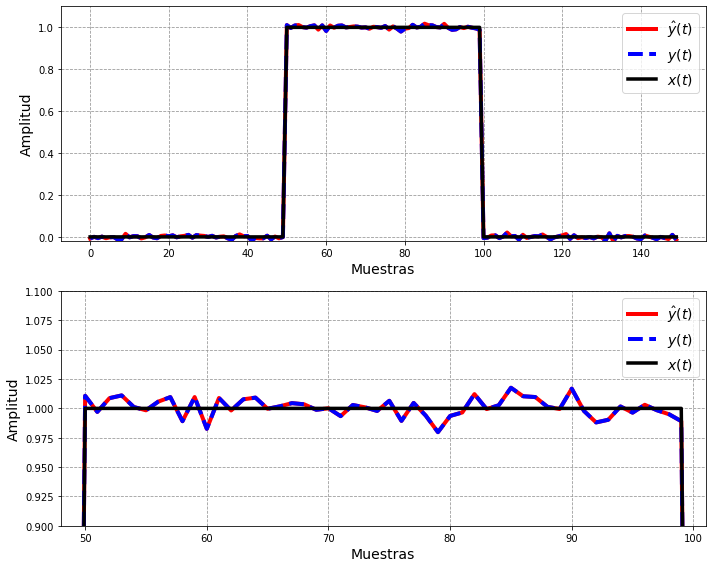

In [13]:
# Ejemplo de mínimos cuadrados ordinarios

# Dado que se va a estimar una constante, nuestro regresor es unitario (escalar)
phi = 1

# Nuestro vector de parámetros estimados
theta = ((phi * phi)**(-1)) * (phi * output_signal)
"""
Nota:
Dado que el regresor es constante, 'theta' se reduce a que es igual a 
'output_signal', lo anterior es solo de forma ilustrativa.
"""

# Finalmente obtenemos la salida estimada
y_hat = phi * theta  # Esto resultará en un valor constante

# Gráfica de la señal estimada
plt.figure(figsize=(10, 8))

# Subgráfico 1
plt.subplot(2, 1, 1)
plt.plot(y_hat , 'r-', linewidth=4, label='$\\hat{y}(t)$')  
plt.plot(output_signal, 'b--', linewidth=4, label='$y(t)$')
plt.plot(input_signal, 'k-', linewidth=3.5, label='$x(t)$')
plt.grid(True, linestyle='--', color=(0.6, 0.6, 0.6))
plt.ylim([min(output_signal), 1.1])
plt.legend(fontsize=14)
plt.xlabel('Muestras', fontsize=14)
plt.ylabel('Amplitud', fontsize=14)

# Subgráfico 2
plt.subplot(2, 1, 2)
plt.plot(y_hat, 'r-', linewidth=4, label='$\\hat{y}(t)$')  # Hacer un vector constante
plt.plot(output_signal, 'b--', linewidth=4, label='$y(t)$')
plt.plot(input_signal, 'k-', linewidth=3.5, label='$x(t)$')
plt.grid(True, linestyle='--', color=(0.6, 0.6, 0.6))
plt.ylim([0.9, 1.1])
plt.xlim([48, 101])
plt.legend(fontsize=14)
plt.xlabel('Muestras', fontsize=14)
plt.ylabel('Amplitud', fontsize=14)

plt.tight_layout()
plt.show()


Al emplear este método, se debe tener en cuenta que es un método por lotes y sensible al ruido. Al estimar la constante, el regresor se vuelve unitario, lo que provoca que la señal estimada sea igual a la señal de salida, la cual está afectada por ruido. Por esta razón, se concluye que:

$$\hat{y}(k) = y(k) = x(k) + e(k),$$

## Mínimos Cuadrados Recursivos (RLS).

Debido a las limitaciones de los mínimos cuadrados ordinarios, surge el método de mínimos cuadrados recursivos, siendo una alternativa eficiente para la estimación de parámetros en tiempo discreto, con la ventaja de poder implementarse en tiempo real.

Este método permite incorporar información del sistema en el instante $k+1$, tanto en el regresor como en las mediciones de la salida. De esta forma, el vector de estimación de parámetros se puede expresar como:

$$\hat{\theta}_{k+1} = \left[\phi(k)\phi^{T}(k) +\phi(k+1)\phi^{T}(k+1)\right]^{-1} [\phi(k)y(k) + \phi(k+1)y(k+1)], \quad (4)$$

siendo la ecuación ($4$) aquella que puede ser calculada de manera recursiva. 

A continuación, se define una nueva matriz, denominada matriz de covarianza:

$$P_k = \left[ \phi(k)\phi^T(k) \right]^{-1}, \quad (5)$$

de esta matriz (ecuación 5), es posible deducir la siguiente expresión:

$$P_{k+1} = \left[ P^{-1}_k + \phi(k+1)\phi^T(k+1)\right]^{-1}, $$

Utilizando el lema de inversión de matrices en la ecuación anterior, se obtiene:

$$P_{k+1} = P_k - \frac{P_k\phi(k)\phi^T(k)P_k}{1+\phi^T(k)P_k\phi(k)}, \quad (6)$$

Combinando las ecuaciones ($4$) y ($6$), el vector de estimación de parámetros se define como:


$$\hat{\theta}_{k+1} = \hat{\theta}_k + P_{k+1}\phi(k)[y(k) - \phi^T(k)\hat{\theta}_k]. \quad (7)$$

Por conveniencia, se introduce el siguiente término:

$$K(k) = P_{k+1}\phi(k), \quad (8)$$

este término es conocido como **ganancia de Kalman**.

Finalmente, la estimación del vector de parámetros mediante el algoritmo de mínimos cuadrados recursivos está dada por:

$$\hat{\theta}_{k+1} = \hat{\theta}_k + K(k)\epsilon(k). \quad (9)$$

### Inicialización del aloritmo RLS.
La implementación del algoritmo RLS resulta de las ecuaciones ($1$), ($6$), ($8$) y  ($9$). Si únicamente se cuenta con las mediciones de entrada y salida del sistema, es posible construir el vector de regresión $\phi$. Sin embargo, es necesario asignar valores iniciales a $\hat{\theta}_k$ y $P_k$, siendo $\hat{\theta}_k (0)$ y $P_k (0)$ los parámetros requeridos para la inicialización del algoritmo. Como se señala en la literatura {cite}`soderstrom1989system`, si $P_k (0)$ es muy pequeño, entonces la ganancia de Kalman $K(k)$ será pequeña para todas las muestras, lo que provocará que las estimaciones de los parámetros no se alejen significativamente de $\hat{\theta}_k(0)$. Por el contrario, si $P_k (0)$ es muy grande, las estimaciones del vector de parámetros se desviarán rápidamente del valor inicial $\hat{\theta}_k(0)$. 

En situaciones donde no se dispone de conocimiento previo del sistema, una práctica común es inicializar los valores de $\hat{\theta}_k$ y $P_k$, de la siguiente manera:

$$\hat{\theta}_k(0) = \bar{0} \quad P_k = \gamma I, $$

donde $\gamma$ es un número muy grande, e $I$ es la matriz identidad, cuyas dimensiones dependen de la construcción del regresor.


### Ejemplo de los Mínimos Cuadrados Recursivos.

Veamos ahora un ejemplo de la aplicación de este algoritmo. 

In [14]:
# Inicialización de valores para el algoritmo
P = 10000
phi = 1
theta = 0

# Simulación de datos de ejemplo
length = len(output_signal)

# Configuración de la gráfica
fig, ax = plt.subplots(figsize=(10, 8))
ax.grid(True, color=[0.6, 0.6, 0.6], linestyle='--')
ax.set_xlim(0, length)
ax.set_ylim(min(output_signal), 1.1)
ax.set_xlabel('Muestras', fontsize=14)
ax.set_ylabel('Amplitud', fontsize=14)

# Inicialización para el gráfico
plot_theta, = ax.plot([], [], 'r-', linewidth=4, label=r'$\hat{y}(t)$')
plot_output, = ax.plot([], [], 'b--', linewidth=4, label=r'$y(t)$')
plot_input, = ax.plot([], [], 'k-', linewidth=3.5, label=r'$x(t)$')
ax.legend(fontsize=14)

theta_values = [theta]


def update(frame):
    global P, theta, phi

    # Algoritmo RLS
    epsilon = output_signal[frame] - phi * theta
    P = P - (P * phi * phi * P) / (1 + phi * P * phi)
    K = P * phi
    theta = theta + K * epsilon
    theta_values.append(theta)
    
    # Actualización de los datos de la gráfica
    plot_theta.set_data(range(len(theta_values)), theta_values)
    plot_output.set_data(range(frame + 1), output_signal[:frame + 1])
    plot_input.set_data(range(frame + 1), input_signal[:frame + 1])
    
    return plot_theta, plot_output, plot_input

# Configuración de la animación
ani = FuncAnimation(fig, update, frames=range(1, length), blit=True, interval=50)


plt.close(fig) 
HTML(ani.to_jshtml())

En la gráfica superior se presenta una animación que simula la adquisición de mediciones de entrada $x(k)$, salida $y(k)$ y la salida estimada $\hat{y}(k)$, simulando un proceso en *tiempo real*. Una de las principales ventajas de los mínimos cuadrados recursivos frente a los mínimos cuadrados ordinarios es la posibilidad de ser aplicados en tiempo real. Para realizar la estimación, no es necesario contar con el lote completo de datos de entrada y salida; la cantidad de datos requeridos dependerá de la estructura del modelo, pero no se necesita almacenar el conjunto completo. En este caso, dado que el regresor es unitario, es suficiente trabajar con variables escalares.

En el código anterior, se utilizó un vector auxiliar para almacenar los primeros 50 valores de la estimación. A continuación, se presenta su gráfica.

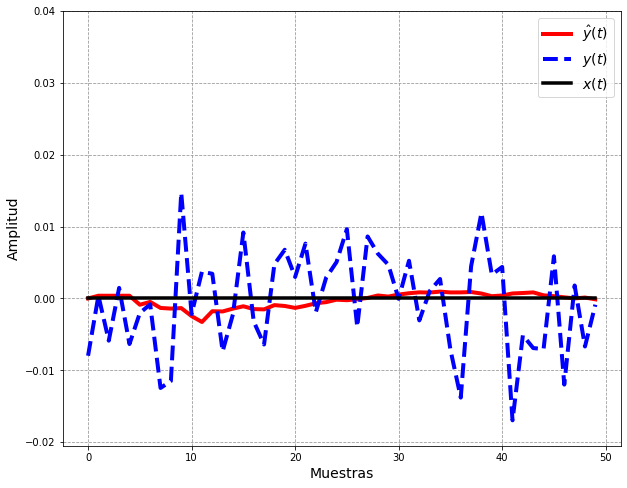

In [15]:
# Conversión a arrays para graficar los primeros 50 valores
theta_values = np.array(theta_values[:50])
output_50 = output_signal[:50]
input_50 = input_signal[:50]

# Configuración de la gráfica
fig, ax = plt.subplots(figsize=(10, 8))
ax.plot(theta_values, 'r-', linewidth=4, label=r'$\hat{y}(t)$')
ax.plot(output_50, 'b--', linewidth=4, label=r'$y(t)$')
ax.plot(input_50, 'k-', linewidth=3.5, label=r'$x(t)$')

# Personalización de la cuadrícula y los ejes
ax.grid(True, color=[0.6, 0.6, 0.6], linestyle='--')
ax.set_ylim(min(output_signal), 0.04)
ax.legend(fontsize=14)

plt.xlabel('Muestras', fontsize=14)
plt.ylabel('Amplitud', fontsize=14)
plt.show()

Se puede observar que la estimación durante este intervalo es adecuada, ya que logró reducir la influencia del ruido en las estimaciones a lo largo del tiempo. Sin embargo, como se mostró en la animación, ante cambios abruptos, el algoritmo no fue capaz de seguir correctamente la señal de salida.

Este problema puede solucionarse ajustando el peso que se otorga a las nuevas mediciones en comparación con las anteriores, como se analizará a continuación.

## Mínimos Cuadrados Recursivos con Factor de Olvido.

Es posible incluir un factor de peso llamado **factor de olvido** $\lambda \in (0,1]$. Este factor tiene como objetivo asignar un mayor peso a las mediciones más recientes en comparación con las anteriores. En consecuencia, la nueva función de costo se define como

$$V = \sum_{i=1}^k \lambda^{k-i}\epsilon^2(k), $$

En esta implementación, las ecuaciones previamente presentadas para los mínimos cuadrados recursivos permanecen sin cambios, con la única modificación en la ecuación ($6$), como se muestra a continuación:

$$P_{k+1} = \frac{1}{\lambda}\left(P_k - \frac{P_k\phi(k)\phi^T(k)P_k}{\lambda+\phi^T(k)P_k\phi(k)}\right)$$


### Resumen de las ecuaciones para la implementación de los Mínimos Cuadrados Recursivos con Factor de Olvido.
Las siguientes ecuaciones representan las ecuaciones necesarias para implemenrae el algoritmo RLS, esto a manera de resumen y con variantes presentadas en {cite}`soderstrom1989system`:

$$\hat{\theta}_{k+1} = \hat{\theta}_k + K(k)\epsilon(k)$$

$$\epsilon(k) = y(k) - \phi^T(k)\hat{\theta}_k$$

$$K(k) = P_{k+1}\phi(k) = \frac{P_k \phi(k)}{\lambda + \phi^T(k)P_k \phi(k)}$$

$$P_{k+1} = \frac{1}{\lambda}\left(P_k - \frac{P_k\phi(k)\phi^T(k)P_k}{\lambda+\phi^T(k)P_k\phi(k)}\right)$$

### Ejemplo de los Mínimos Cuadrados Recursivos con Factor de Olvido.

A continuación, se presentará un ejemplo que muestra estos cambios, y se compararán los resultados con los obtenidos mediante los mínimos cuadrados recursivos con el factor de olvido.
```{warning}
Con la siguiente celda de código es posible modificar el factor de olvido. Para esto es importante seguir los siguientes pasos.
1. Consultar la sección `Ejecución de códigos` en el Capítulo `Sobre el libro` y seguir las instrucciones.
2. Después de realizar lo anterior, ir a la celda de código visible posterior a la nota del capítulo, donde se importan las bibliotecas necesarias, y presionar el botón `run`.
3. Una vez realiza lo anterior, modificar el valor del factor de olvido teniendo en cuenta que $\lambda \in (0,1]$.
4. Presionar el botón `run` una vez modificado el valor.
5. Desplegar la celda de código inmediata posterior (presionando el botón ➡️`Show code cell source`) y presionar  el botón `run`.

```


In [16]:
"""
Celda para modificar el Factor de olvido -> (0,1]
"""
lambda_factor = 0.5

In [17]:

# Inicialización de valores para el algoritmo
P = 1000
phi = 1
theta = 0

# Simulación de datos de ejemplo
length = len(output_signal)

# Configuración de la gráfica
fig, ax = plt.subplots(figsize=(10, 8))
ax.grid(True, color=[0.6, 0.6, 0.6], linestyle='--')
ax.set_xlim(0, length)
ax.set_ylim(min(output_signal), 1.1)
ax.set_xlabel('Muestras', fontsize=14)
ax.set_ylabel('Amplitud', fontsize=14)

# Inicialización de las líneas para theta, output y input
plot_theta, = ax.plot([], [], 'r-', linewidth=4, label=r'$\hat{y}(t)$')
plot_output, = ax.plot([], [], 'b--', linewidth=4, label=r'$y(t)$')
plot_input, = ax.plot([], [], 'k-', linewidth=3.5, label=r'$x(t)$')
ax.legend(fontsize=14)

theta_values = [theta]

# Función de actualización para la animación
def update(frame):
    global P, theta, phi, lambda_factor

    # Algoritmo RLS con factor de olvido
    epsilon = output_signal[frame] - phi * theta
    P = (1 / lambda_factor) * (P - (P * phi * phi * P) / (lambda_factor + phi * P * phi))
    K = P * phi
    theta = theta + K * epsilon
    theta_values.append(theta)
    
    # Actualización de los datos de la gráfica
    plot_theta.set_data(range(len(theta_values)), theta_values)
    plot_output.set_data(range(frame + 1), output_signal[:frame + 1])
    plot_input.set_data(range(frame + 1), input_signal[:frame + 1])
    
    return plot_theta, plot_output, plot_input

# Configuración de la animación
ani = FuncAnimation(fig, update, frames=range(1, length), blit=True, interval=50)


plt.close(fig)  
HTML(ani.to_jshtml())

## Ejemplo final de los algoritmos.

Finalmente, se puede realizar una comparación para la estimación de una constante en el mismo sistema, aunque ahora la señal de entrada será una senoidal.





In [18]:
"""
Celda para modificar el Factor de olvido -> (0,1]
Seguir los pasos anteriores para una correcta ejecución (Bloque de advertencia)
"""
lambda_factor = 0.4

In [19]:
# Señal de entrada
n = np.linspace(0, 1, 150)
input_signal = np.sin(2 * np.pi * 5 * n)
# Ruido
noise = 0.008 * np.random.randn(150)
# Señal de salida
output = input_signal + noise

# Inicialización de valores para el algoritmo
P = 1000
phi = 1
theta = 0
P1 = 1000
theta1 = 0

# Configuración de la gráfica
fig, ax = plt.subplots(figsize=(10, 8))
ax.grid(True, color=[0.6, 0.6, 0.6], linestyle='--')
ax.set_xlim(0, 150)
ax.set_ylim(min(output), 1.1)
ax.set_xlabel('Muestras', fontsize=14)
ax.set_ylabel('Amplitud', fontsize=14)

# Inicialización de las líneas para theta, theta con lambda, output y input
plot_theta, = ax.plot([], [], 'r-', linewidth=4, label=r'$\hat{y}(t)$')
plot_theta1, = ax.plot([], [], 'g-', linewidth=4, label=r'$\hat{y}_{\lambda}(t)$')
plot_output, = ax.plot([], [], 'b--', linewidth=4, label=r'$y(t)$')
plot_input, = ax.plot([], [], 'k-', linewidth=3.5, label=r'$x(t)$')
ax.legend(fontsize=14)

theta_values = [theta]
theta1_values = [theta1]

# Función de actualización para la animación
def update(frame):
    global P, theta, P1, theta1, phi

    # Algoritmo RLS sin factor de olvido
    epsilon = output[frame] - phi * theta
    P = P - (P * phi * phi * P) / (1 + phi * P * phi)
    K = P * phi
    theta = theta + K * epsilon
    theta_values.append(theta)
    
    # Algoritmo RLS con factor de olvido
    epsilon1 = output[frame] - phi * theta1
    P1 = (1 / lambda_factor) * (P1 - (P1 * phi * phi * P1) / (lambda_factor + phi * P1 * phi))
    K1 = P1 * phi
    theta1 = theta1 + K1 * epsilon1
    theta1_values.append(theta1)
    
    # Actualización de los datos de la gráfica
    plot_theta.set_data(range(len(theta_values)), theta_values)
    plot_theta1.set_data(range(len(theta1_values)), theta1_values)
    plot_output.set_data(range(frame + 1), output[:frame + 1])
    plot_input.set_data(range(frame + 1), input_signal[:frame + 1])
    
    return plot_theta, plot_theta1, plot_output, plot_input

# Configuración de la animación
ani = FuncAnimation(fig, update, frames=range(1, len(output)), blit=True, interval=50)

plt.close(fig)  
HTML(ani.to_jshtml())


En este último ejemplo, se puede observar la diferencia en la estimación de la salida entre los algoritmos presentados en esta sección. Para ejemplos más complejos, se pueden consultar las siguientes secciones.